In [1]:
import cv2
import os
import easyocr
import re
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import pickle

In [2]:
from tqdm.notebook import tqdm

In [3]:
%matplotlib inline

# 分类器部分

生成样本

训练模型

In [4]:
from fastai.vision.all import *
path = "./frames1"
files = get_image_files(path)
class_1_set = set(['frame115.jpg','frame528.jpg','frame531.jpg','frame579.jpg','frame630.jpg','frame679.jpg','frame683.jpg','frame728.jpg','frame732.jpg','frame780.jpg','frame783.jpg','frame818.jpg','frame876.jpg','frame924.jpg','frame975.jpg','frame1024.jpg','frame1072.jpg','frame1075.jpg','frame1122.jpg','frame1123.jpg','frame1178.jpg','frame1182.jpg','frame1221.jpg','frame1225.jpg','frame1268.jpg','frame1271.jpg','frame1320.jpg','frame1324.jpg','frame1360.jpg','frame1364.jpg','frame1404.jpg','frame1451.jpg','frame1491.jpg','frame1534.jpg','frame1537.jpg','frame1579.jpg','frame1580.jpg','frame1583.jpg','frame1620.jpg','frame1623.jpg','frame1664.jpg','frame1713.jpg','frame1716.jpg','frame1751.jpg','frame1754.jpg','frame1794.jpg','frame1799.jpg','frame1834.jpg','frame1870.jpg','frame1912.jpg','frame1913.jpg','frame1959.jpg','frame1996.jpg'])
class_2_set = set(['frame14.jpg','frame134.jpg','frame393.jpg','frame538.jpg','frame539.jpg','frame558.jpg','frame591.jpg','frame592.jpg','frame689.jpg','frame755.jpg','frame756.jpg','frame840.jpg','frame889.jpg','frame890.jpg','frame960.jpg','frame961.jpg','frame1300.jpg','frame1301.jpg','frame1418.jpg','frame1549.jpg','frame1676.jpg','frame1774.jpg','frame1775.jpg','frame1900.jpg'])
def label_func(f): 
    if f in class_1_set:
        return 1
    elif f in class_2_set:
        return 2
    else:
        return 0
dls = ImageDataLoaders.from_name_func(path, files, label_func, item_tfms=Resize((224, 224), method='squish'))
learn = vision_learner(dls, resnet34, metrics=error_rate)

/Users/sroot/anaconda3/lib/python3.11/site-packages/fastai/torch_core.py:263: UserWarning: 'has_mps' is deprecated, please use 'torch.backends.mps.is_built()'
  return getattr(torch, 'has_mps', False)


Could not do one pass in your dataloader, there is something wrong in it. Please see the stack trace below:


RuntimeError: The MPS backend is supported on MacOS 12.3+.Current OS version can be queried using `sw_vers`

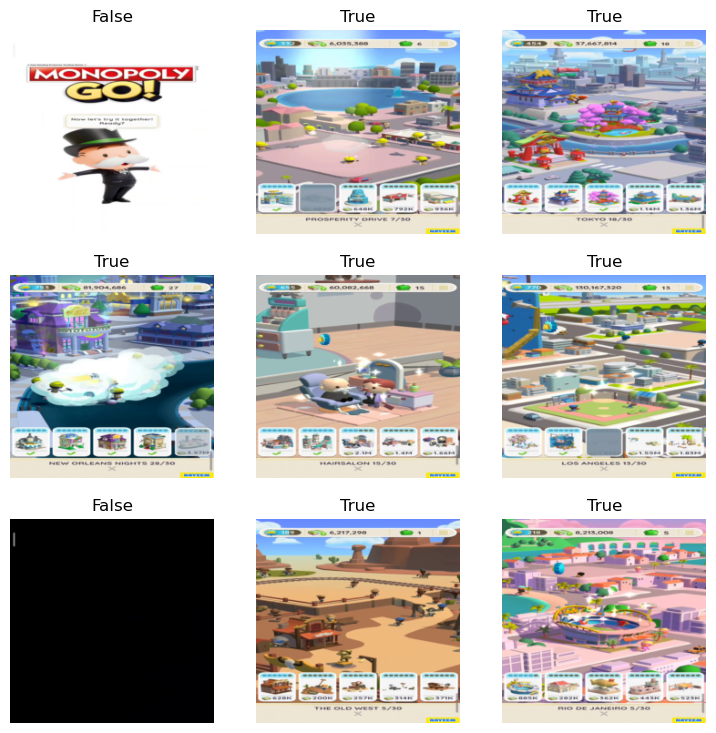

In [6]:
dls.show_batch()

In [8]:
learn.fine_tune(4, 3e-2)

epoch,train_loss,valid_loss,error_rate,time
0,0.000000,0.630515,0.086957,00:02


epoch,train_loss,valid_loss,error_rate,time
0,0.000000,0.017646,0.021739,00:02
1,0.000000,0.000075,0.000000,00:02
2,0.000000,0.000004,0.000000,00:02
3,0.000000,0.000001,0.000000,00:02


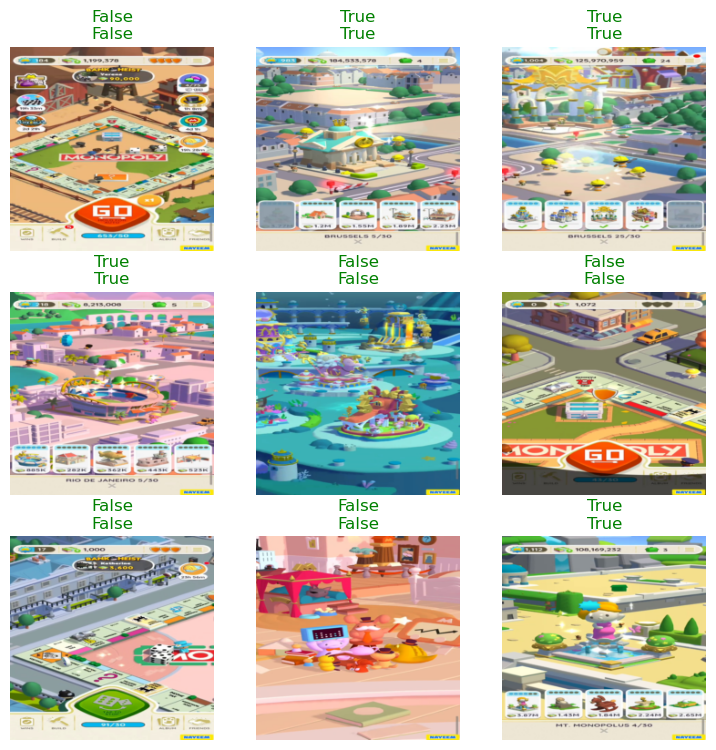

In [18]:
learn.show_results()

In [9]:
learn.save('/home/ubuntu/projects/extract_stats_from_mg_video/model/data_extract_model')

Path('/home/ubuntu/projects/extract_stats_from_mg_video/model/data_extract_model.pth')

In [20]:
# 创建 OCR reader
reader = easyocr.Reader(['en'])  # 'en' 表示使用英语模式

img_path = './frames/frame99.jpg'
image = Image.open(img_path)

result = extract_text_from_image(reader, image, True)

In [21]:
result[0]

{'area_2': 648000,
 'area_3': 792000,
 'area_4': 936000,
 'city': 'PROSPERITY DRIVE',
 'current_progress': 7,
 'total_progress': 30}

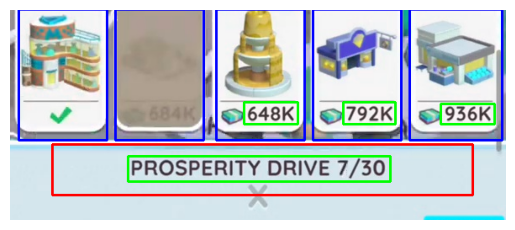

In [22]:
plt.imshow(result[1])
plt.axis('off')
plt.show()

In [ ]:
result_list = extract_data_from_video('./monopolygo_large.mp4', learn, reader, 7, -1, 1000, 1000)

Processing video:   0%|          | 0/471653 [00:00<?, ?it/s]

convert_abbreviation_to_number error: BE1


convert_abbreviation_to_number error: BE1


convert_abbreviation_to_number error: BBB


convert_abbreviation_to_number error: BBB


convert_abbreviation_to_number error: 2 08K


convert_abbreviation_to_number error: .


convert_abbreviation_to_number error: 5 76K


IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



convert_abbreviation_to_number error: H07K


convert_abbreviation_to_number error: H07K


convert_abbreviation_to_number error: B12K


convert_abbreviation_to_number error: BK


convert_abbreviation_to_number error: H35K


convert_abbreviation_to_number error: A35K


convert_abbreviation_to_number error: A35K


convert_abbreviation_to_number error: 78.4


convert_abbreviation_to_number error: 146K<


convert_abbreviation_to_number error: 75,59K


convert_abbreviation_to_number error: 86.8


convert_abbreviation_to_number error: 1971:


convert_abbreviation_to_number error: '


convert_abbreviation_to_number error: A


convert_abbreviation_to_number error: S09K


convert_abbreviation_to_number error: 497;=


convert_abbreviation_to_number error:  ' |


convert_abbreviation_to_number error: 60SK


convert_abbreviation_to_number error:  = - |


convert_abbreviation_to_number error: Z14K


convert_abbreviation_to_number error: 36|


convert_abbreviation_to_number error: |


convert_abbreviation_to_number error: S85K


convert_abbreviation_to_number error: S03K


convert_abbreviation_to_number error: Z64K


convert_abbreviation_to_number error:  |


convert_abbreviation_to_number error: BA4


convert_abbreviation_to_number error: BA4K


convert_abbreviation_to_number error: 10SM


convert_abbreviation_to_number error: B24K


convert_abbreviation_to_number error: 1.09M;


convert_abbreviation_to_number error: 1.091 =


convert_abbreviation_to_number error: 3711;


convert_abbreviation_to_number error: A


convert_abbreviation_to_number error: 1.096 =


convert_abbreviation_to_number error: 46 9K


convert_abbreviation_to_number error: 4691<


convert_abbreviation_to_number error: Z16K


convert_abbreviation_to_number error: 0AM


convert_abbreviation_to_number error: 1 ` .


convert_abbreviation_to_number error: 1.26M;


convert_abbreviation_to_number error: M


convert_abbreviation_to_number error: SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.08M;


convert_abbreviation_to_number error: 162M,


convert_abbreviation_to_number error:  |


convert_abbreviation_to_number error: 1.59M,


convert_abbreviation_to_number error:  .


convert_abbreviation_to_number error: 1,52M


convert_abbreviation_to_number error: '


convert_abbreviation_to_number error: 1 Q1M


convert_abbreviation_to_number error: 6 6M


convert_abbreviation_to_number error: V


convert_abbreviation_to_number error: V


convert_abbreviation_to_number error: 1J4M


convert_abbreviation_to_number error: 1,34M


convert_abbreviation_to_number error: SM


convert_abbreviation_to_number error: 1,.9M


convert_abbreviation_to_number error: 0AM


convert_abbreviation_to_number error: 1,.81M


convert_abbreviation_to_number error: Z.06M


convert_abbreviation_to_number error: 1SM


convert_abbreviation_to_number error: |


convert_abbreviation_to_number error: 1,38M


convert_abbreviation_to_number error: 1,.59M


convert_abbreviation_to_number error: 2.1SM


convert_abbreviation_to_number error: 2.1SM


convert_abbreviation_to_number error: 2 41M


convert_abbreviation_to_number error: 1,.77M


convert_abbreviation_to_number error: S10K


convert_abbreviation_to_number error: S10K


convert_abbreviation_to_number error: 1.026 =


convert_abbreviation_to_number error: 1,28M


convert_abbreviation_to_number error: 1.281


convert_abbreviation_to_number error: 1,48M


convert_abbreviation_to_number error: 2.151


convert_abbreviation_to_number error: 2.4SM


convert_abbreviation_to_number error: H4SM


convert_abbreviation_to_number error: 1,38M


convert_abbreviation_to_number error: 1.381


convert_abbreviation_to_number error: A


convert_abbreviation_to_number error: M


convert_abbreviation_to_number error: 3 06M


convert_abbreviation_to_number error: 1 040-4


convert_abbreviation_to_number error: 2.29M,


convert_abbreviation_to_number error: S1M


convert_abbreviation_to_number error: 1.S1M


convert_abbreviation_to_number error: 1.S1M


convert_abbreviation_to_number error: 1.S1M


convert_abbreviation_to_number error: 2SM


convert_abbreviation_to_number error: 1,2M


convert_abbreviation_to_number error: A9N


convert_abbreviation_to_number error: HM


convert_abbreviation_to_number error: 1 62M


convert_abbreviation_to_number error: ZA


convert_abbreviation_to_number error: 2-B1M


convert_abbreviation_to_number error: ZM


convert_abbreviation_to_number error: 135M;


convert_abbreviation_to_number error: ZS6M


convert_abbreviation_to_number error: 1 - 5^


convert_abbreviation_to_number error: 1 :!


convert_abbreviation_to_number error: 1,BM


convert_abbreviation_to_number error: 2.B1M


convert_abbreviation_to_number error: 3 14M


convert_abbreviation_to_number error: 2,02M


convert_abbreviation_to_number error: 1 57M4


convert_abbreviation_to_number error: 145]


convert_abbreviation_to_number error: 14SM


convert_abbreviation_to_number error: 1.7SM


convert_abbreviation_to_number error: 1.6 9M


convert_abbreviation_to_number error: 1.63M,


convert_abbreviation_to_number error: 1 936


convert_abbreviation_to_number error: 2.236


convert_abbreviation_to_number error: AR


convert_abbreviation_to_number error: AR


convert_abbreviation_to_number error:  .


convert_abbreviation_to_number error: 1SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1,141'
convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M
convert_abbreviation_to_number error: 2.52; 


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 'K


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.67M;
convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.S5M


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.'
convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1 56M
convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 4,55M


convert_abbreviation_to_number error: 3,071


convert_abbreviation_to_number error: 3,07M


convert_abbreviation_to_number error: 3,56M


convert_abbreviation_to_number error: 3,56M


convert_abbreviation_to_number error: 1,35M


convert_abbreviation_to_number error: 1.SM


convert_abbreviation_to_number error: 2.37,


convert_abbreviation_to_number error: 1.BM


convert_abbreviation_to_number error: S4M


convert_abbreviation_to_number error: 4-54M


convert_abbreviation_to_number error: 01N


convert_abbreviation_to_number error: 4,.34M


convert_abbreviation_to_number error: 4.920


convert_abbreviation_to_number error: 2.73N


convert_abbreviation_to_number error: 2.73M.


convert_abbreviation_to_number error: @M


convert_abbreviation_to_number error: 4-8M


convert_abbreviation_to_number error: 4-S9M


convert_abbreviation_to_number error: 2.SM


convert_abbreviation_to_number error: 5.01N


convert_abbreviation_to_number error: 5,01M


convert_abbreviation_to_number error: 4.041


convert_abbreviation_to_number error: 4.4BM


convert_abbreviation_to_number error: S


convert_abbreviation_to_number error: 6,SSM


convert_abbreviation_to_number error: 5.Q1M


convert_abbreviation_to_number error: 3.451


convert_abbreviation_to_number error: 4,40-1


convert_abbreviation_to_number error: 5.431


convert_abbreviation_to_number error: 5.121


convert_abbreviation_to_number error: 5.85M,


convert_abbreviation_to_number error: 5 ^4M4


convert_abbreviation_to_number error: 3 76M


convert_abbreviation_to_number error: 4.28M.


convert_abbreviation_to_number error: 4.95M;


convert_abbreviation_to_number error: ZAM


convert_abbreviation_to_number error: ZZM


convert_abbreviation_to_number error: 2 7M


convert_abbreviation_to_number error: 2.591


convert_abbreviation_to_number error: J . M


convert_abbreviation_to_number error: 3,04M


convert_abbreviation_to_number error: 5.620


convert_abbreviation_to_number error: 3,49M


convert_abbreviation_to_number error: 3,49M


convert_abbreviation_to_number error: 4 0SM


convert_abbreviation_to_number error: 4.05M;


convert_abbreviation_to_number error: 4,05M


convert_abbreviation_to_number error: 4.61M;


convert_abbreviation_to_number error: 6,07M


convert_abbreviation_to_number error: 6,07M


convert_abbreviation_to_number error: 5-13M


convert_abbreviation_to_number error: 1.B1M


convert_abbreviation_to_number error: 58N


convert_abbreviation_to_number error: S.3M


convert_abbreviation_to_number error: 5.SM


convert_abbreviation_to_number error: 5,05M


convert_abbreviation_to_number error: 5,05M


convert_abbreviation_to_number error: 5,78M


convert_abbreviation_to_number error: 2 77M


convert_abbreviation_to_number error: 3.971


convert_abbreviation_to_number error: 5,540


convert_abbreviation_to_number error: 6.261


convert_abbreviation_to_number error: 74/


convert_abbreviation_to_number error: 4.33


convert_abbreviation_to_number error: 6 SM


convert_abbreviation_to_number error: 7.22M.


convert_abbreviation_to_number error: 1.627
convert_abbreviation_to_number error: Z54M


convert_abbreviation_to_number error: 2 31M


convert_abbreviation_to_number error: 7 )


convert_abbreviation_to_number error: 4.38M,


convert_abbreviation_to_number error: 5.S3M


convert_abbreviation_to_number error: 5.53M;


convert_abbreviation_to_number error: 3,8M


convert_abbreviation_to_number error: 5.3N


convert_abbreviation_to_number error: 5.991


convert_abbreviation_to_number error: 4.26N


convert_abbreviation_to_number error: 4.26,


convert_abbreviation_to_number error: 5.761


convert_abbreviation_to_number error: 47SM


convert_abbreviation_to_number error: 4.7SM


convert_abbreviation_to_number error: 2.481


convert_abbreviation_to_number error: 2.48M,


convert_abbreviation_to_number error: 3,M


convert_abbreviation_to_number error: 5.46N


convert_abbreviation_to_number error: 5 21M


convert_abbreviation_to_number error: 5.21M;


convert_abbreviation_to_number error: 3,41M


convert_abbreviation_to_number error: 5.ZM


convert_abbreviation_to_number error: 3.351


convert_abbreviation_to_number error: 4-59M


convert_abbreviation_to_number error: M


convert_abbreviation_to_number error: 6,2M


convert_abbreviation_to_number error: A


convert_abbreviation_to_number error: 3,85M


convert_abbreviation_to_number error: 5.85, _


convert_abbreviation_to_number error: 5,09M


convert_abbreviation_to_number error: 5,09M


convert_abbreviation_to_number error: 5,09M


convert_abbreviation_to_number error: Z.44M


convert_abbreviation_to_number error: 2.664


convert_abbreviation_to_number error: 3.32M,


convert_abbreviation_to_number error: 5.B4N


convert_abbreviation_to_number error: 3A9M


convert_abbreviation_to_number error: 5.58M:


convert_abbreviation_to_number error: 3,06M4


convert_abbreviation_to_number error: 3 721


convert_abbreviation_to_number error: 4-91M


convert_abbreviation_to_number error: 4 2M


convert_abbreviation_to_number error: 5,44M


convert_abbreviation_to_number error: 5,44M


convert_abbreviation_to_number error: ZAZM


convert_abbreviation_to_number error: 7A7M


convert_abbreviation_to_number error: Z.17M


convert_abbreviation_to_number error: 7 97M


convert_abbreviation_to_number error: 5.1SM


convert_abbreviation_to_number error: 7.46M;


convert_abbreviation_to_number error: 8H17M


convert_abbreviation_to_number error: 8,17M


convert_abbreviation_to_number error: BM


convert_abbreviation_to_number error: 5.69M;


convert_abbreviation_to_number error: 5.51M;


convert_abbreviation_to_number error: 5.S1M


convert_abbreviation_to_number error: 5 S1M


convert_abbreviation_to_number error: 5 51M


convert_abbreviation_to_number error: |


convert_abbreviation_to_number error: 9.59ME


convert_abbreviation_to_number error: H0 ZM


convert_abbreviation_to_number error: H0.7M


convert_abbreviation_to_number error: M10.Z7M


convert_abbreviation_to_number error: 6,SM


convert_abbreviation_to_number error: H10.3M


convert_abbreviation_to_number error: H10.3M


convert_abbreviation_to_number error: 6 31M


convert_abbreviation_to_number error: 6 SM


convert_abbreviation_to_number error: 7-29M


convert_abbreviation_to_number error: 7.29M;


convert_abbreviation_to_number error: 9.85M;


convert_abbreviation_to_number error: Z.1M


convert_abbreviation_to_number error: Z.1M


convert_abbreviation_to_number error: H0.ZM


convert_abbreviation_to_number error: 2.85M,


convert_abbreviation_to_number error: 3.61M;


convert_abbreviation_to_number error: S5M


In [101]:
import pandas as pd

In [25]:
df = pd.DataFrame(result_list)

In [26]:
df[df.city == 'BARCELONA']

,area_0,area_1,area_2,area_3,area_4,city,current_progress,total_progress,frame
10380,10800000.0,15100000.0,19390000.0,23700000.0,28000000.0,BARCELONA,0.0,30.0,468559
10381,NaN,15100000.0,19390000.0,23700000.0,28000000.0,BARCELONA,0.0,30.0,468601
10382,16200000.0,15100000.0,19390000.0,23700000.0,28000000.0,BARCELONA,1.0,30.0,468608
10383,NaN,15100000.0,19390000.0,23700000.0,28000000.0,BARCELONA,1.0,30.0,468650
10384,16200000.0,15100000.0,19390000.0,23700000.0,28000000.0,BARCELONA,1.0,30.0,468657
...,...,...,...,...,...,...,...,...,...
10476,NaN,NaN,NaN,NaN,NaN,BARCELONA,29.0,30.0,471226
10477,NaN,NaN,NaN,NaN,64590000.0,BARCELONA,29.0,30.0,471233
10478,NaN,NaN,NaN,NaN,NaN,BARCELONA,29.0,30.0,471268
10479,NaN,NaN,NaN,NaN,64590000.0,BARCELONA,29.0,30.0,471275


In [ ]:
extract_data_from_video

In [77]:
# 每隔多少帧处理一次
frame_skip = 30
frame_count = 0

video = cv2.VideoCapture('./monopolygo_large.mp4')
max_image = 30
i = 0
j = 0
while video.isOpened():
    # 读取视频的下一帧
    ret, frame = video.read()
    if not ret:
        break
    j += 1
    # 在这里处理帧，例如进行图像识别或其他分析
    
    # 显示帧
    #cv2.imshow('Frame', frame)
    if (j%frame_skip==0):
        i+=1
        cv2.imwrite('./frames/frame_a'+str(i)+'.jpg', frame)
    if i == max_image:
        break

# 释放视频对象和窗口
video.release()
#cv2.destroyAllWindows()



In [22]:
import pandas as pd

In [23]:
df = pd.DataFrame(result_list)

In [24]:
df.head()

,area_0,area_1,area_2,area_3,area_4,city,current_progress,total_progress,frame
0,240.0,312.0,384.0,888.0,528.0,NEW YORK CITY,0.0,0.0,1065
1,240.0,312.0,384.0,1280.0,528.0,NEW YORK CITY,0.0,0.0,1095
2,240.0,312.0,384.0,NaN,528.0,NEW YORK CITY,0.0,0.0,1185
3,240.0,512.0,384.0,NaN,NaN,NaN,NaN,NaN,5475
4,240.0,312.0,384.0,NaN,528.0,NEW YORK CITY,3.0,15.0,5490
